In [0]:
%matplotlib inline

In [0]:
!pip install -U -q PyDrive
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tensorflow.train import AdamOptimizer
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPool2D
from tensorflow.keras.layers import Activation, Dropout, Flatten, Dense
from tensorflow.keras.callbacks import CSVLogger

from pydrive.auth import GoogleAuth
from pydrive.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials
import zipfile, os

In [0]:
# 1. Authenticate and create the PyDrive client.
auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

if not os.path.exists('MODEL'):
    os.makedirs('MODEL')

# DOWNLOAD ZIP
zip_id = '1Pd3rXJG6Hb9kuFKf7q5o1XRdhl3qWBDr'
print ("Downloading zip file")
myzip = drive.CreateFile({'id': zip_id})
myzip.GetContentFile('model.zip')

# UNZIP ZIP
print ("Uncompressing zip file")
zip_ref = zipfile.ZipFile('model.zip', 'r')
zip_ref.extractall('MODEL/')
zip_ref.close()

Uncompressing zip file


In [0]:
GOOGLE_COLAB = True
TRAINED_MODEL = True
TRAINING_LOGS_FILE = "training_logs.csv"
MODEL_SUMMARY_FILE = "model_summary.txt"
TEST_FILE = "test_file.txt"

if GOOGLE_COLAB:
    !pip install livelossplot
from livelossplot import PlotLossesKeras


Using TensorFlow backend.


In [0]:
# Data augmentation
training_data_generator = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True)
validation_data_generator = ImageDataGenerator(rescale=1./255)
test_data_generator = ImageDataGenerator(rescale=1./255)

In [0]:
# Data
path = "MODEL/"

training_data_dir = path + "dataset/training_set"
validation_data_dir = path + "dataset/validation_set"
test_data_dir = path + "dataset/test_set"

In [0]:
# Hyperparams
IMAGE_SIZE = 200
IMAGE_WIDTH, IMAGE_HEIGHT = IMAGE_SIZE, IMAGE_SIZE
EPOCHS = 20
BATCH_SIZE = 32
TEST_SIZE = 30

In [0]:
# Data preparation
training_generator = training_data_generator.flow_from_directory(
    training_data_dir,
    target_size=(IMAGE_WIDTH, IMAGE_HEIGHT),
    batch_size=BATCH_SIZE,
    class_mode="binary")
validation_generator = validation_data_generator.flow_from_directory(
    validation_data_dir,
    target_size=(IMAGE_WIDTH, IMAGE_HEIGHT),
    batch_size=BATCH_SIZE,
    class_mode="binary")
test_generator = test_data_generator.flow_from_directory(
    test_data_dir,
    target_size=(IMAGE_WIDTH, IMAGE_HEIGHT),
    batch_size=1,
    class_mode="binary", 
    shuffle=False)

Found 4119 images belonging to 2 classes.
Found 459 images belonging to 2 classes.
Found 187 images belonging to 1 classes.


In [0]:
input_shape = (IMAGE_WIDTH, IMAGE_HEIGHT, 3)

In [0]:
# Model 1
model1 = Sequential()

model1.add(Conv2D(32, (3, 3), padding='same', input_shape=input_shape, activation='relu'))
model1.add(Conv2D(32, (3, 3), padding='same', activation='relu'))
model1.add(MaxPool2D(pool_size=(2, 2)))

model1.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model1.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model1.add(MaxPool2D(pool_size=(2, 2)))

model1.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model1.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model1.add(MaxPool2D(pool_size=(2, 2)))

model1.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model1.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model1.add(MaxPool2D(pool_size=(2, 2)))

model1.add(Flatten())
model1.add(Dense(256, activation='relu'))
model1.add(Dropout(0.5))

model1.add(Dense(256, activation='relu'))
model1.add(Dropout(0.5))

model1.add(Dense(1, activation='sigmoid'))
    
model1.compile(loss='binary_crossentropy',
            optimizer=AdamOptimizer(learning_rate = 0.0001),
            metrics=['accuracy'])



In [0]:
# Reload weights from google drive into the model

if(TRAINED_MODEL):
  last_weight_file = drive.CreateFile({'id': '1qcLq_r1_3akmktsWT8H5YlKCnHa5Y0_x'}) 
  last_weight_file.GetContentFile('last_weights.mat')
  model1.load_weights('last_weights.mat')


In [0]:
# Training
if(not TRAINED_MODEL):
  model1.fit_generator(
      training_generator,
      steps_per_epoch=len(training_generator.filenames) // BATCH_SIZE,
      epochs=EPOCHS,
      validation_data=validation_generator,
      validation_steps=len(validation_generator.filenames) // BATCH_SIZE,
      callbacks=[PlotLossesKeras(), CSVLogger(TRAINING_LOGS_FILE,
                                              append=False,
                                              separator=";")], 
      verbose=1)

In [0]:
# Save weights to google drive
if(not TRAINED_MODEL):
  model1.save_weights('model_weights.h5')
  weights_file = drive.CreateFile({'title' : 'model_weights.h5'})
  weights_file.SetContentFile('model_weights.h5')
  weights_file.Upload()
  drive.CreateFile({'id': weights_file.get('id')})

In [0]:
# Model 2

model2 = Sequential()

model2.add(Conv2D(32, (3, 3), padding='same', input_shape=input_shape, activation='relu'))
model2.add(Conv2D(32, (3, 3), padding='same', activation='relu'))
model2.add(MaxPool2D(pool_size=(2, 2)))

model2.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model2.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model2.add(MaxPool2D(pool_size=(2, 2)))

model2.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model2.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model2.add(MaxPool2D(pool_size=(2, 2)))

model2.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model2.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model2.add(MaxPool2D(pool_size=(2, 2)))

model2.add(Flatten())
model2.add(Dense(256, activation='relu'))
model2.add(Dropout(0.5))

model2.add(Dense(256, activation='relu'))
model2.add(Dropout(0.5))

model2.add(Dense(1, activation='sigmoid'))

model2.compile(loss='binary_crossentropy',
            optimizer=AdamOptimizer(learning_rate =0.00001),
            metrics=['accuracy'])


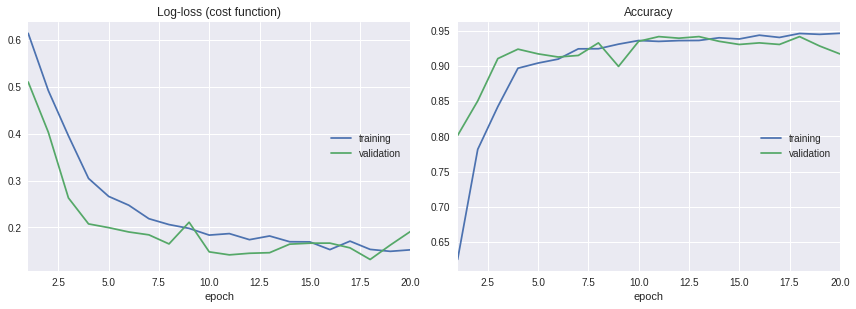

Log-loss (cost function):
training   (min:    0.149, max:    0.614, cur:    0.152)
validation (min:    0.131, max:    0.510, cur:    0.191)

Accuracy:
training   (min:    0.625, max:    0.947, cur:    0.947)
validation (min:    0.801, max:    0.942, cur:    0.917)
128/128 [==============================] - 60s 466ms/step - loss: 0.1524 - acc: 0.9465 - val_loss: 0.1912 - val_acc: 0.9174


In [0]:
# Training
if(not TRAINED_MODEL):
  model2.fit_generator(
      training_generator,
      steps_per_epoch=len(training_generator.filenames) // BATCH_SIZE,
      epochs=EPOCHS,
      validation_data=validation_generator,
      validation_steps=len(validation_generator.filenames) // BATCH_SIZE,
      callbacks=[PlotLossesKeras(), CSVLogger(TRAINING_LOGS_FILE,
                                              append=False,
                                              separator=";")], 
      verbose=1)
  model2.save_weights(MODEL_FILE)

In [0]:
# Model 3
model3 = Sequential()

model3.add(Conv2D(32, (3, 3), padding='same', input_shape=input_shape, activation='relu'))
model3.add(Conv2D(32, (3, 3), padding='same', activation='relu'))
model3.add(MaxPool2D(pool_size=(2, 2)))

model3.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model3.add(Conv2D(64, (3, 3), padding='same', activation='relu'))
model3.add(MaxPool2D(pool_size=(2, 2)))

model3.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model3.add(Conv2D(128, (3, 3), padding='same', activation='relu'))
model3.add(MaxPool2D(pool_size=(2, 2)))

model3.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model3.add(Conv2D(256, (3, 3), padding='same', activation='relu'))
model3.add(MaxPool2D(pool_size=(2, 2)))

model3.add(Flatten())
model3.add(Dense(256, activation='relu'))
model3.add(Dropout(0.5))

model3.add(Dense(256, activation='relu'))
model3.add(Dropout(0.5))

model3.add(Dense(1, activation='sigmoid'))
    
model3.compile(loss='binary_crossentropy',
            optimizer=AdamOptimizer(learning_rate =0.001),
            metrics=['accuracy'])


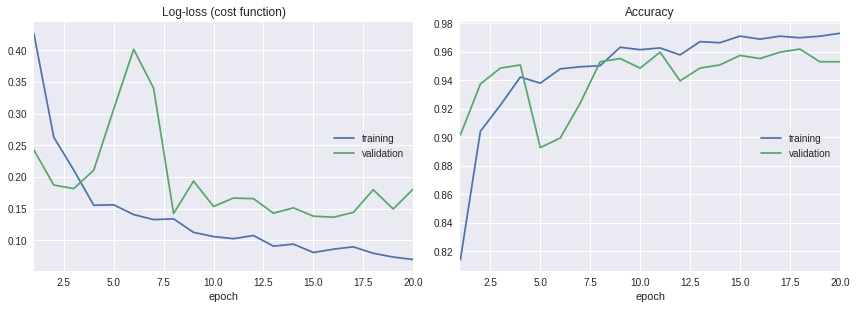

Log-loss (cost function):
training   (min:    0.070, max:    0.427, cur:    0.070)
validation (min:    0.136, max:    0.402, cur:    0.181)

Accuracy:
training   (min:    0.814, max:    0.973, cur:    0.973)
validation (min:    0.893, max:    0.962, cur:    0.953)
128/128 [==============================] - 59s 462ms/step - loss: 0.0696 - acc: 0.9731 - val_loss: 0.1811 - val_acc: 0.9531


In [0]:
# Training
if(not TRAINED_MODEL):
  model3.fit_generator(
      training_generator,
      steps_per_epoch=len(training_generator.filenames) // BATCH_SIZE,
      epochs=EPOCHS,
      validation_data=validation_generator,
      validation_steps=len(validation_generator.filenames) // BATCH_SIZE,
      callbacks=[PlotLossesKeras(), CSVLogger(TRAINING_LOGS_FILE,
                                              append=False,
                                              separator=";")], 
      verbose=1)

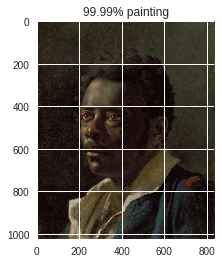

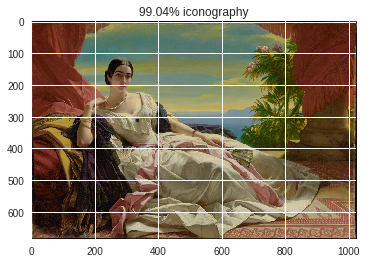

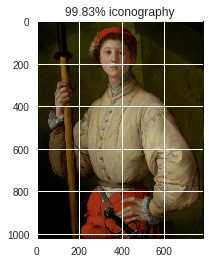

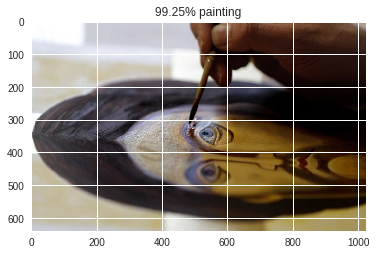

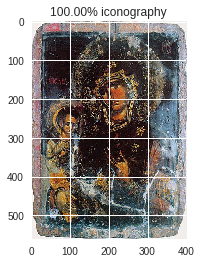

...

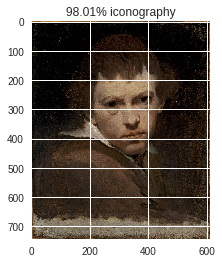

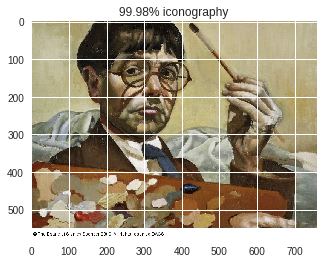

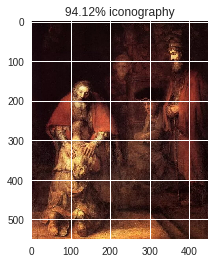

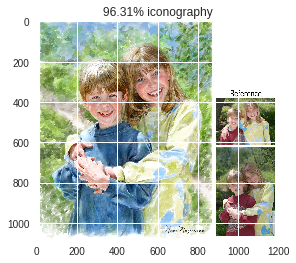

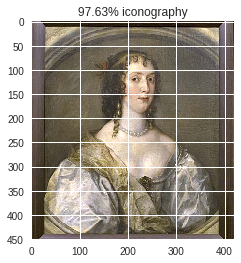

In [0]:
TEST_SIZE = 187

probabilities = model1.predict_generator(test_generator, TEST_SIZE)
for index, probability in enumerate(probabilities):
    image_path = test_data_dir + "/" +test_generator.filenames[index]
    img = mpimg.imread(image_path)
    with open(TEST_FILE,"a") as fh:
        fh.write(str(probability[0]) + " for: " + image_path + "\n")
   # plt.imshow(img)
    if probability > 0.5:
        plt.title("%.2f" % (probability[0]*100) + "% painting")
        plt.imshow(img)
    else:
        plt.title("%.2f" % ((1-probability[0])*100) + "% iconography")
        plt.imshow(img)
    plt.show()